In [1]:
import torch
from skimage import io
from skimage import io
import matplotlib.pyplot as plt
import cv2

from tqdm import tqdm

%matplotlib inline

In [2]:
from google.colab.patches import cv2_imshow # for image display


In [14]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
if torch.cuda.is_available(): 
   device = 'cuda' 
else: 
   device = 'cpu' 

device

'cuda'

In [5]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5x').to(device)  # or yolov5m, yolov5l, yolov5x, custom

Downloading: "https://github.com/ultralytics/yolov5/archive/master.zip" to /root/.cache/torch/hub/master.zip
requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13

requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

YOLOv5 🚀 2022-3-14 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)



  0%|          | 0.00/166M [00:00<?, ?B/s]

Fusing layers... 
Model Summary: 444 layers, 86705005 parameters, 0 gradients
Adding AutoShape... 


In [18]:
Path      = "archrive"
Path      = "/content/drive/MyDrive/My viedo/"    
filename  = "IMG_8813.mp4"


print(Path+filename)

/content/drive/MyDrive/My viedo/IMG_8813.mp4


In [19]:
# capture the video
cap = cv2.VideoCapture(Path+filename)

# check if capture was successful
if not cap.isOpened(): 
    print("Could not open!")
else:
    print("Video read successful!")
    
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    width        = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height       = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps          = cap.get(cv2.CAP_PROP_FPS)
    
    print('Total frames: ' + str(total_frames))
    print('width: ' + str(width))
    print('height: ' + str(height))
    print('fps: ' + str(fps))

Video read successful!
Total frames: 7220
width: 1080
height: 1920
fps: 29.97002997002997


  0%|          | 0/700 [00:00<?, ?it/s]

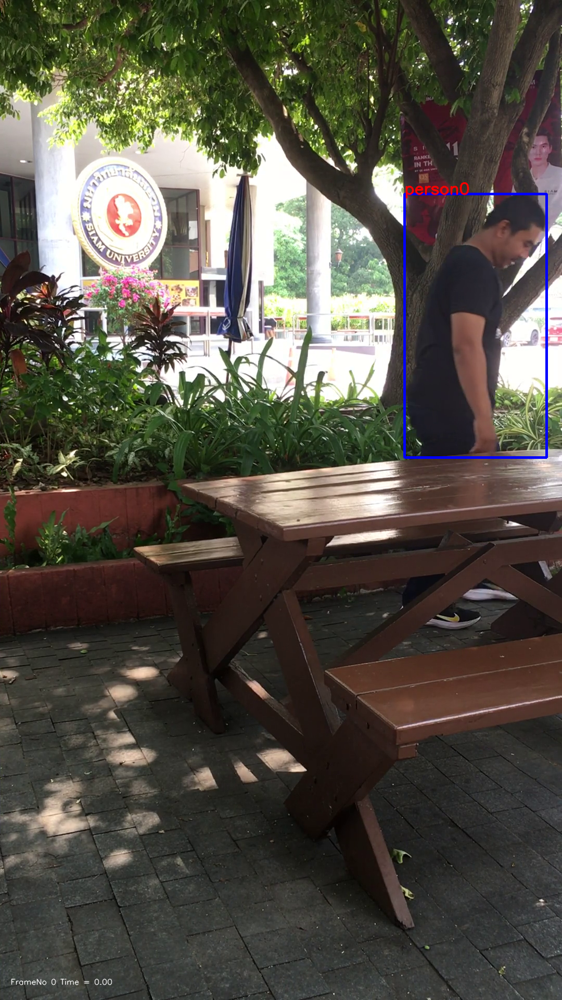

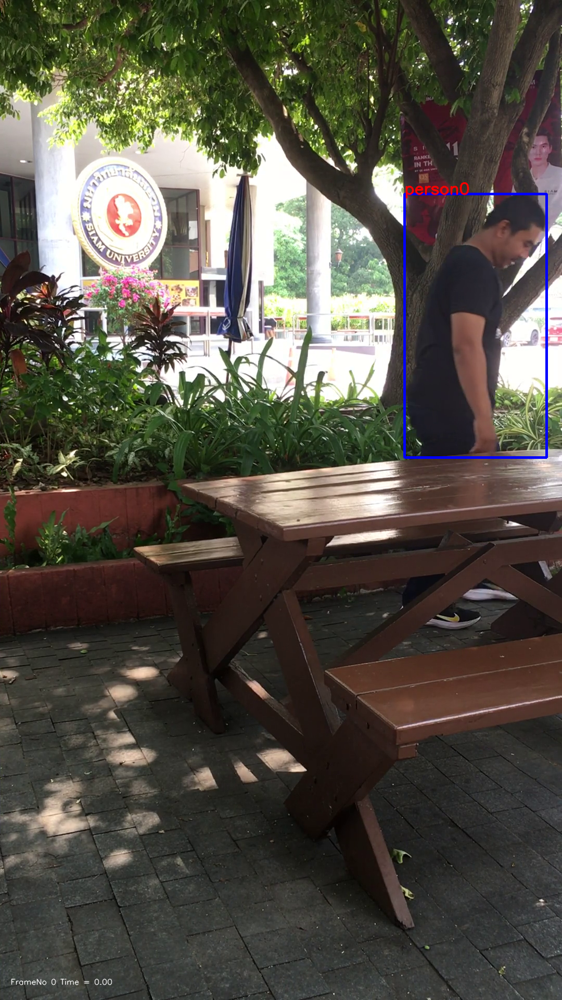

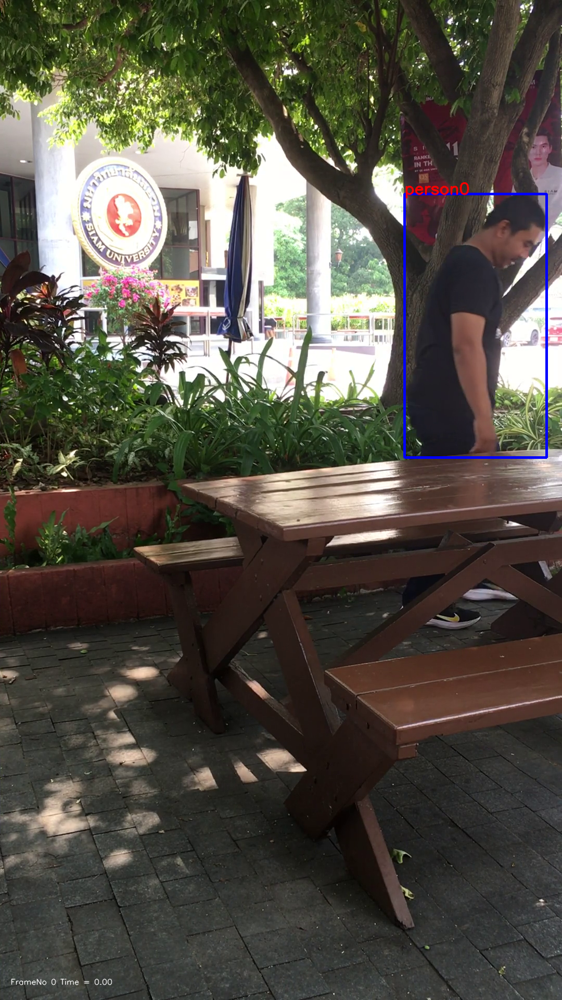

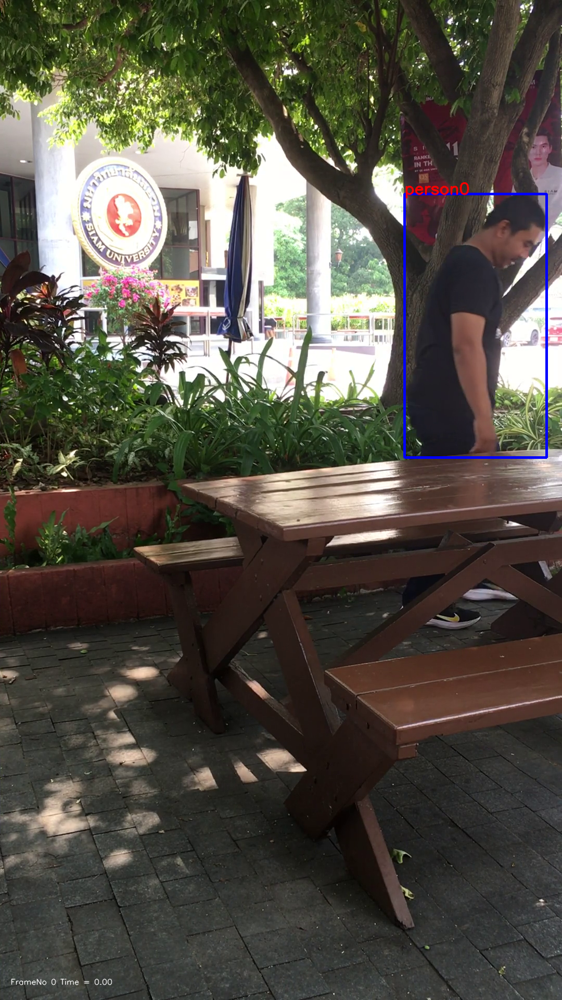

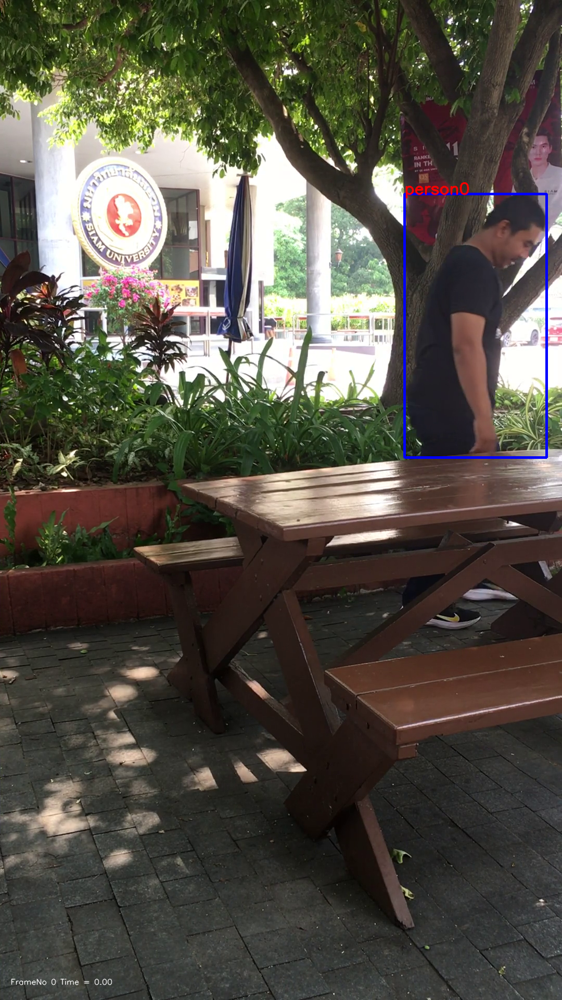

 14%|█▍        | 100/700 [02:16<17:45,  1.78s/it]

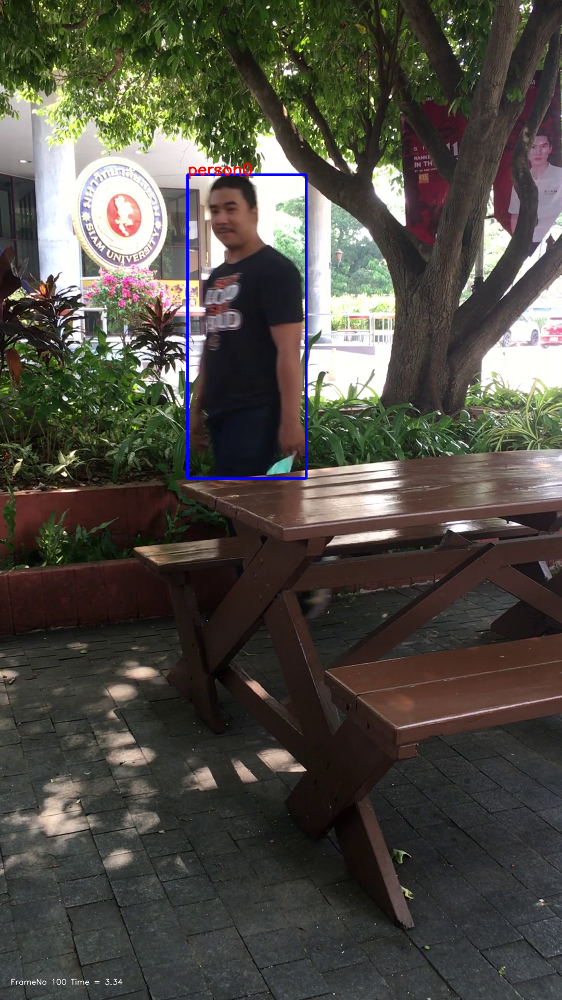

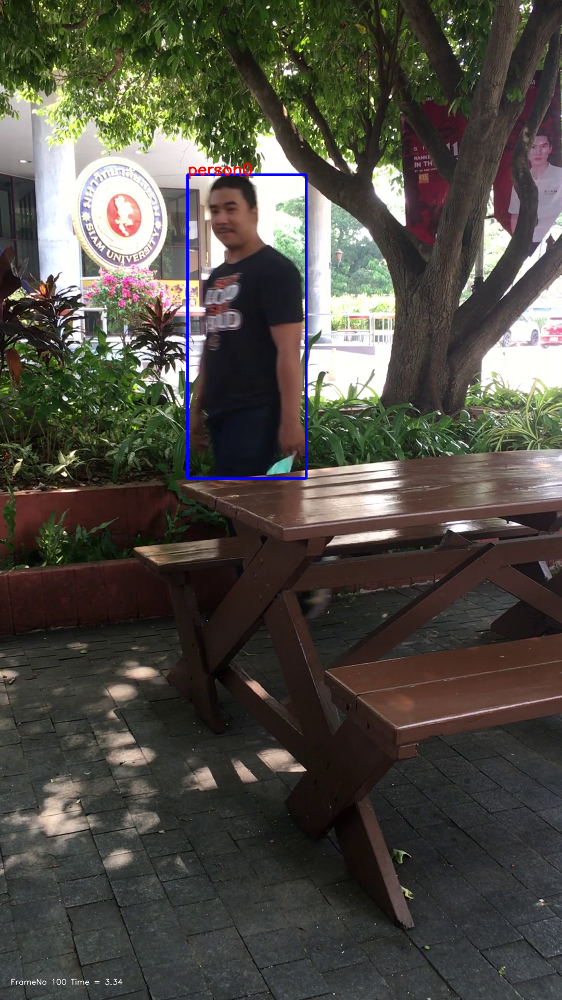

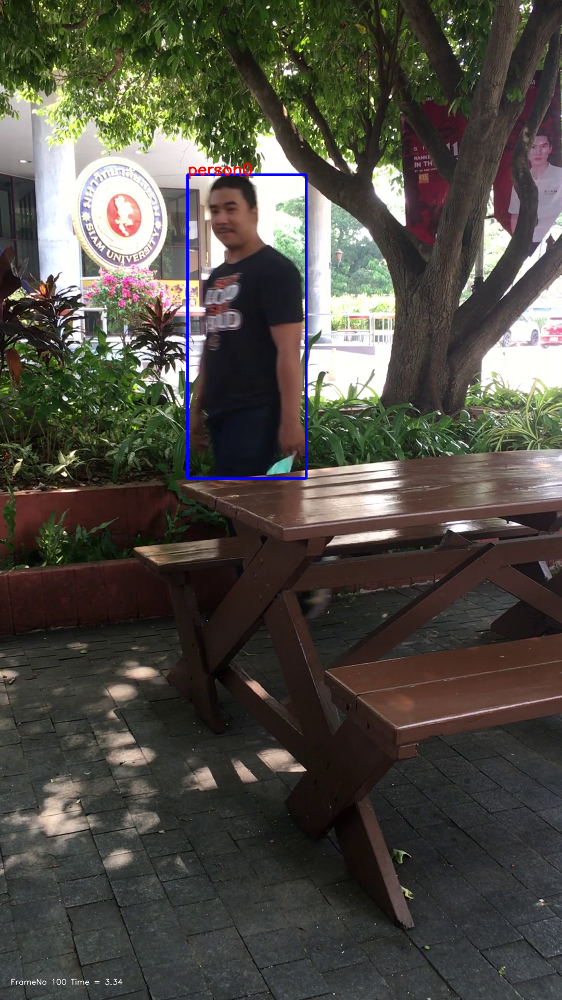

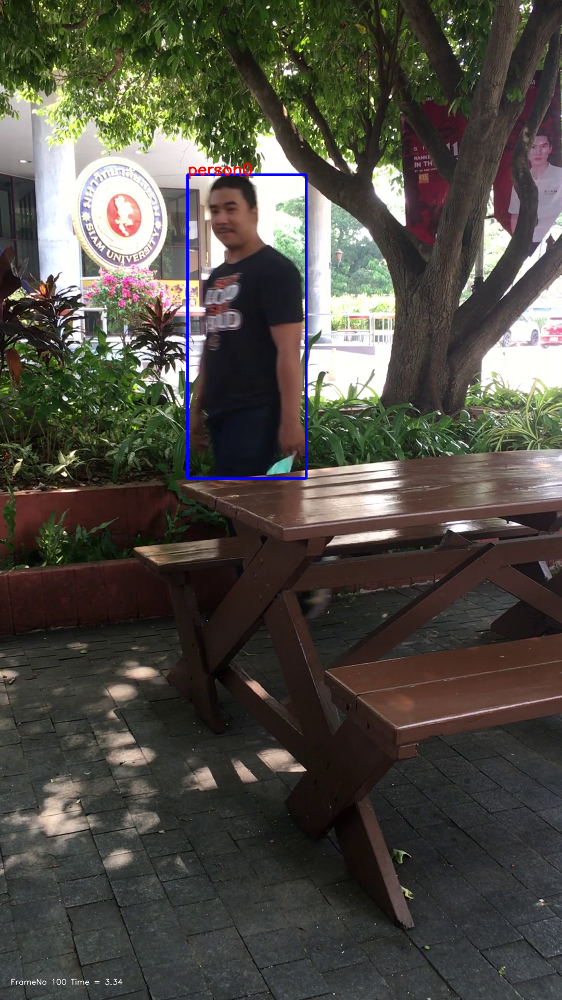

 29%|██▊       | 200/700 [06:17<23:15,  2.79s/it]

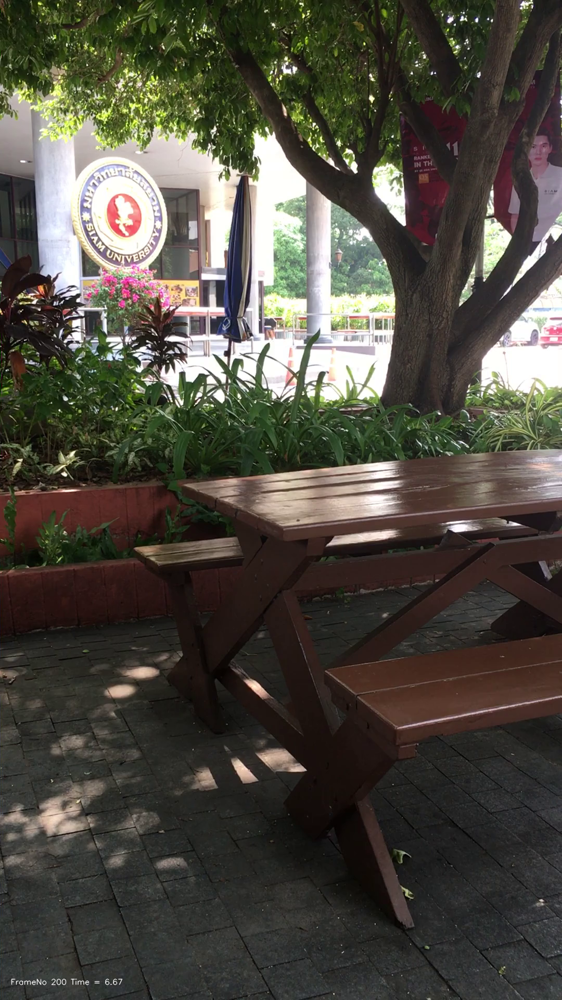

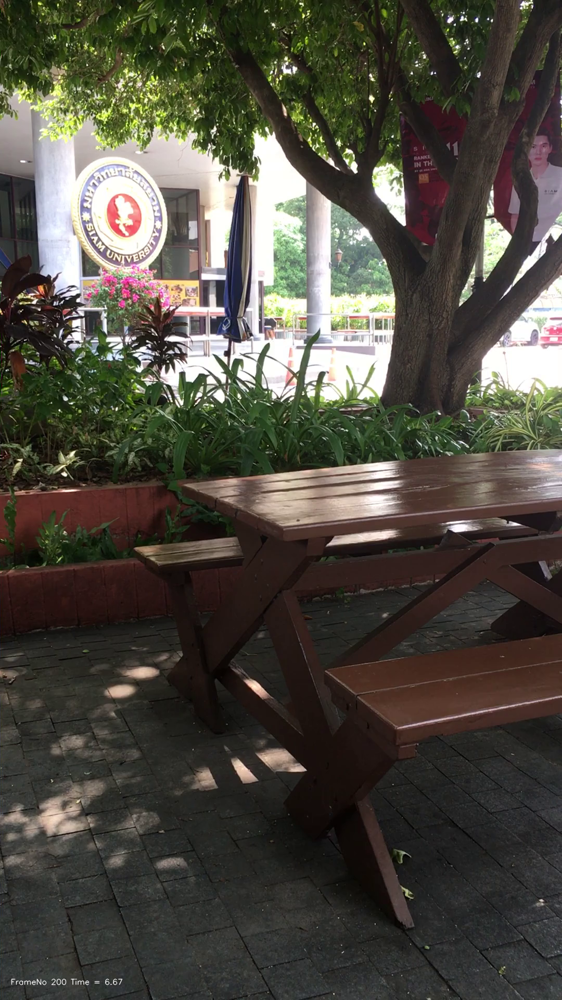

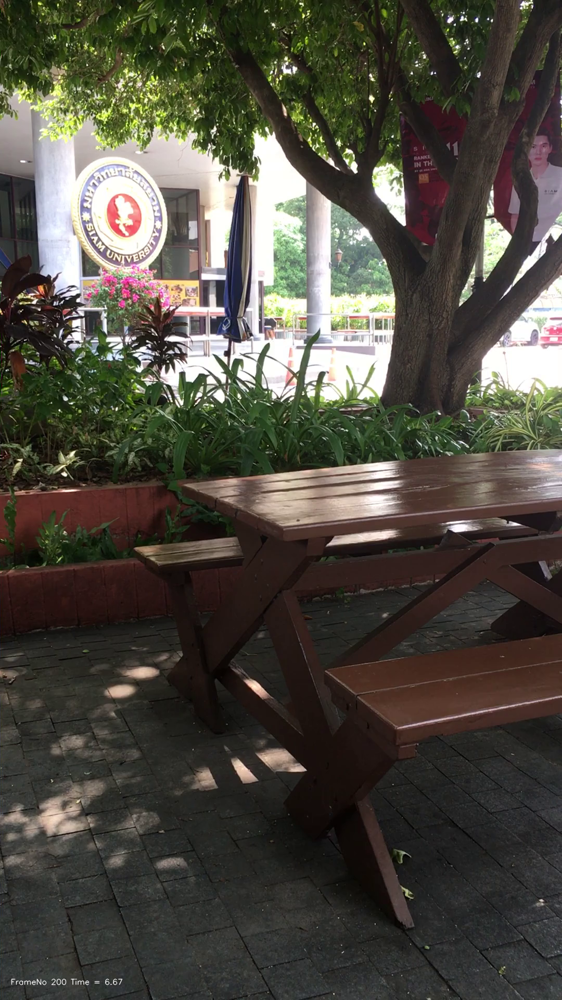

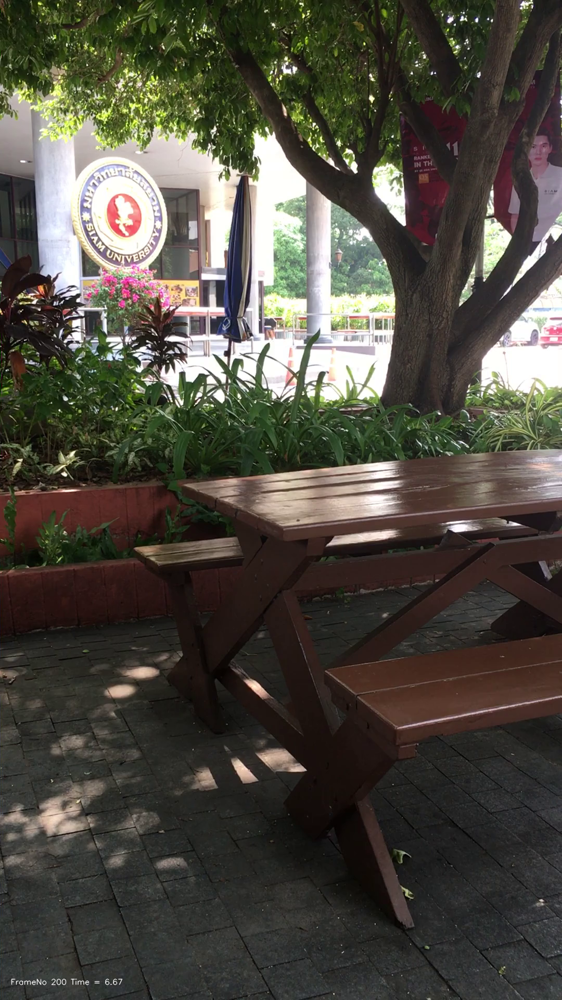

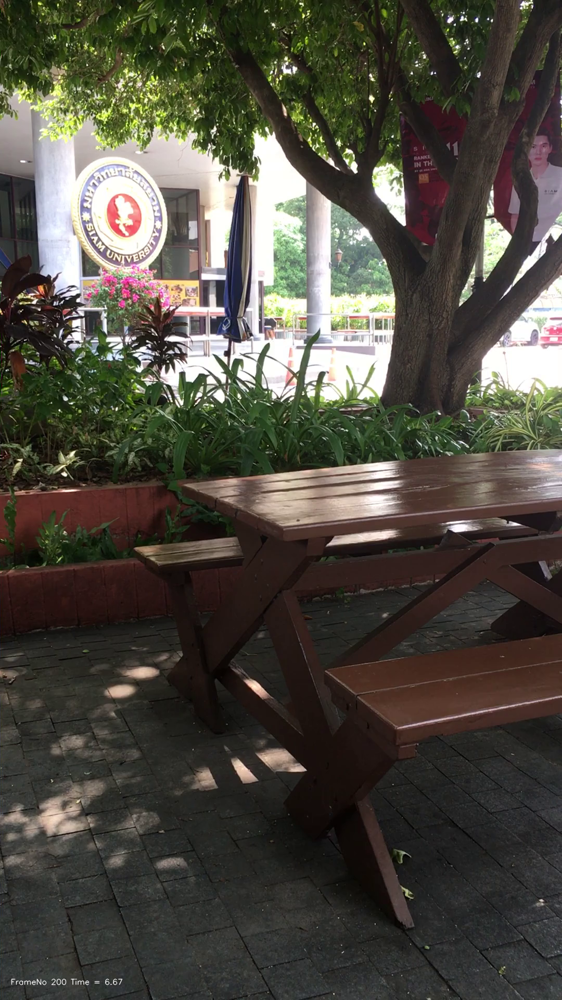

 30%|██▉       | 209/700 [06:51<16:07,  1.97s/it]


KeyboardInterrupt: ignored

In [21]:
savepath = ""
savepath = "/content/drive/MyDrive/Output video"
savefile = 'Test.mp4'

fourcc = cv2.VideoWriter_fourcc(*'MP4V')
out    = cv2.VideoWriter(savepath+savefile, fourcc, fps, (width,height))
    


cap = cv2.VideoCapture(Path+filename)


for i in tqdm(range(800,1500)):

    cap.set(cv2.CAP_PROP_POS_FRAMES, i)    

   # Get the next frame, but don't decode if we're not using it.
    success    = cap.grab()

    ret, image = cap.retrieve()

  

    if  ret :

      duration = (i-800)/fps
      text = f"FrameNo {i-800} Time = {duration:.2f}"

      start_point = (20,height-30)
      image = cv2.putText(image, text, start_point, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA, False)
      


    
      results = model(image)
      Dictdata =  results.pandas().xyxy[0].to_dict('index')
      
      color     = (255, 0, 0)
      thickness = 3

      for key, x in Dictdata.items():
        if x['name'] == 'person' :
            start_point = ( int(x['xmin']), int(x['ymin']) )
            end_point   = ( int(x['xmax']), int(x['ymax']) )
            image = cv2.rectangle(image, start_point, end_point, color, thickness)
            text = x['name']+str(key)
            image = cv2.putText(image, text, start_point, cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2, cv2.LINE_AA, False)
            out.write(image)

        if i% 100 ==0  :
           cv2_imshow(image)
      


out.release()      
cap.release()
